In [24]:
library(ggplot2)
library(dplyr)
library(Matrix)
library(data.table)
library(stringr)
library(patchwork)
library(glue)
library(ggforce)
library(vcfR)
library(purrr)
library(phangorn)
library(magrittr)
library(parallel)
library(ggpubr)
library(tidygraph)
library(extraDistr)
library(IRdisplay)
library(igraph)
library(ggridges)
library(multidplyr)
library(ggtree)
library(ggraph)
library(phangorn)
options(repr.matrix.max.cols=30, repr.matrix.max.rows=20)
options(repr.vector.max.items = 50)

In [722]:
26913 + 29992

[1] 56905

In [546]:
all_samples = c(paste0('ATC', 1:5), paste0('TNBC', 1:5), c('DCIS1'))
cell_counts = cell_annot[all_samples] %>% lapply(nrow) %>% rbind
cell_counts
sum(unlist(cell_counts))

,ATC1,ATC2,ATC3,ATC4,ATC5,TNBC1,TNBC2,TNBC3,TNBC4,TNBC5,DCIS1
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
.,2203,6226,3264,1731,6144,1097,1034,532,3056,3225,1480


[1] 29992

In [2]:
res = list()

cell_annot = fread('~/paper_data/cell_annotations/cell_annot_MDA.tsv') %>%
    split(.$sample)

con_TNBC = readRDS('~/external/MDA/conos_TNBC.rds')
con_ATC = readRDS('~/external/MDA/conos_ATC.rds')

In [6]:
# con_BC = readRDS('~/external/MDA/conos_BC.rds')

# Collage

## TvN

In [67]:
clone_post = lapply(
    c(paste0('ATC', 1:4)), function(sample) {
        fread(glue('~/paper_data/numbat_out/{sample}/clone_post_2.tsv'))
    }
) %>% bind_rows()

clone_post %>% 
    left_join(bind_rows(cell_annot), by = 'cell') %>%
    mutate(
        p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
        numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N')
    ) %>%
    select(copykat.pred, numbat.pred, cluster.pred, sample) %>%
    melt(measure.vars = c('numbat.pred', 'copykat.pred'), variable.name = 'method', value.name = 'pred') %>%
    group_by(method) %>%
    summarise(
        recall = mean(pred[cluster.pred == "T"] == "T"),
        precision = mean(cluster.pred[pred == "T"] == "T")
    )

method,recall,precision
<fct>,<dbl>,<dbl>
numbat.pred,0.9644604,0.9949546
copykat.pred,0.9713075,0.9825198


In [66]:
clone_post = lapply(
    c(paste0('TNBC', 1:5)), function(sample) {
        fread(glue('~/paper_data/numbat_out/{sample}/clone_post_2.tsv'))
    }
) %>% bind_rows()

clone_post %>% 
    left_join(bind_rows(cell_annot), by = 'cell') %>%
    mutate(
        p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
        numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N')
    ) %>%
    select(copykat.pred, numbat.pred, cluster.pred, sample) %>%
    melt(measure.vars = c('numbat.pred', 'copykat.pred'), variable.name = 'method', value.name = 'pred') %>%
    group_by(method) %>%
    summarise(
        recall = mean(pred[cluster.pred == "T"] == "T"),
        precision = mean(cluster.pred[pred == "T"] == "T")
    ) 

method,recall,precision
<fct>,<dbl>,<dbl>
numbat.pred,0.9821980,0.9908375
copykat.pred,0.9778383,0.9860780


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

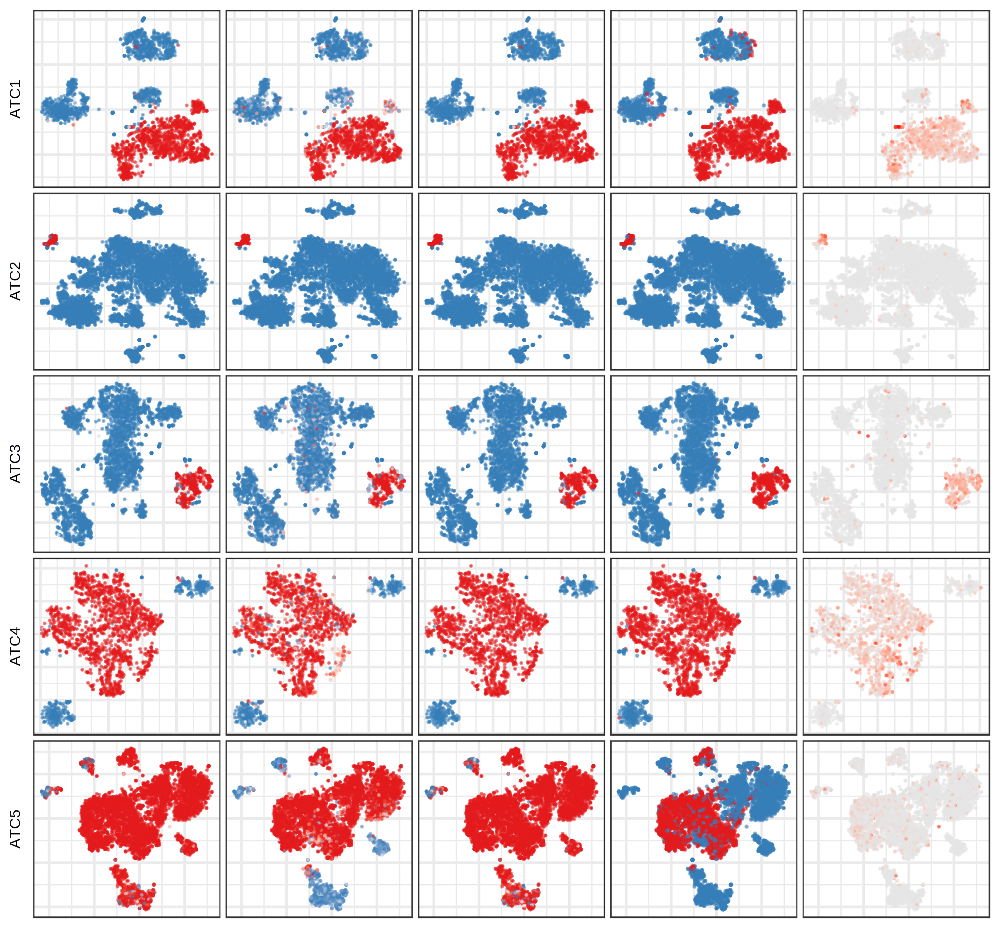

In [173]:
options(repr.plot.width = 7.5, repr.plot.height = 7, repr.plot.res = 300)

joint_plots = list()
copykat_plots = list()
exp_plots = list()
allele_plots = list()
marker_plots = list()
samples = c(paste0('ATC', 1:5))

for (sample in samples) {
    
    if (str_detect(sample, 'ATC')) {
        con = con_ATC
    } else {
        con = con_TNBC
    }

    marker = ifelse(str_detect(sample, 'ATC'), 'KRT8', 'EPCAM')
    
    clone_post = fread(glue('~/paper_data/numbat_out/{sample}/clone_post_2.tsv'))
    
    cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
    cell_clusters = cell_clusters[names(cell_clusters) %in% cell_annot[[sample]]$cell]

    marker_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        plot.na = F,
        groups = cell_clusters,
        plot.theme = theme_bw(),
        gene = marker,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
    exp_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_x, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0),
        axis.title.y = element_text(size = 8)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish) +
    ylab(sample)
    
    allele_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_y, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    #         title = sample,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    joint_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    
    copykat_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.2, 
        groups = cell_annot[[sample]] %>%
            {setNames(.$copykat.pred, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.na = F,
        plot.theme = theme_bw(),
        pal = c(pal[2], pal[1])
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
}

wrap_plots(c(rbind(exp_plots, allele_plots, joint_plots, copykat_plots, marker_plots)), ncol = 5, byrow = T)

## Phylogenies

In [6]:
res = list()

In [43]:
R.utils::sourceDirectory('~/Numbat/R')
for (sample in paste0('TNBC', 2:5)) {
    res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)
}

In [ ]:
for (sample in samples) {
    tree_post = res[[sample]]$tree_post
    max_cost = 400

    G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
                simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
                label_genotype()

    mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
        select(name = node, site = label, clone = clone, GT = GT)

    # update tree
    gtree = mut_to_tree(tree_post$gtree, mut_nodes)
    res[[sample]]$gtree = mark_tumor_lineage(gtree)
}

In [159]:
R.utils::sourceDirectory('~/Numbat/R')

plots = list()

for (sample in paste0('TNBC', 2:5)) {

    plots[[sample]] = plot_sc_joint(
        res[[sample]]$gtree,
        res[[sample]]$joint_post %>%
            mutate(cnv_state_map = cnv_state) %>%
            mutate(cnv_state = ifelse(cnv_state == 'bdel', 'del', cnv_state)),
        res[[sample]]$segs_consensus,
        tip_length = 1,
        branch_width = 0.2,
        size = 0.15,
        cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        logBF_min = 2,
        logBF_max = 5,
        p_min = 0.9,
        clone_bar = T,
        clone_legend = F
    ) +
    ggtitle(sample)
}

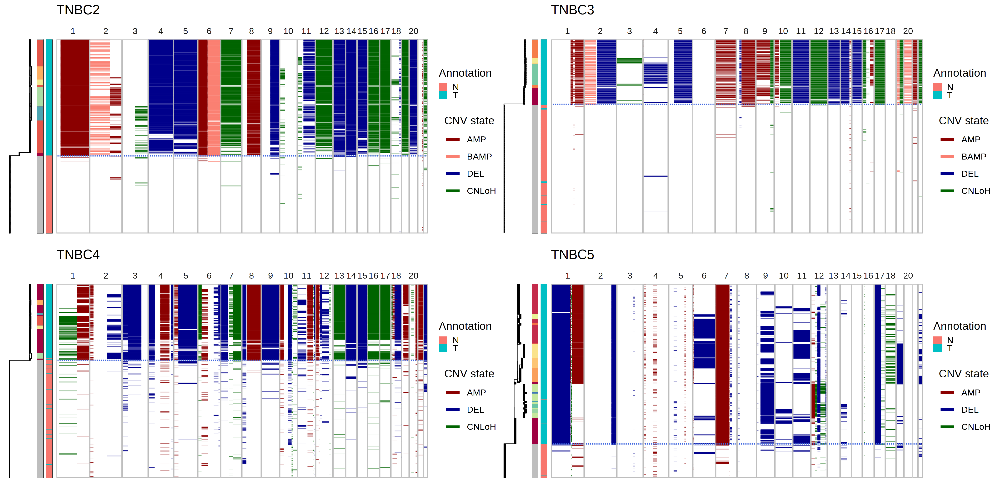

In [161]:
options(repr.plot.width = 14, repr.plot.height = 7, repr.plot.res = 300)

wrap_plots(plots, ncol = 2, guides = 'collect')

In [61]:
for (sample in paste0('ATC', 2:5)) {
    res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)
}

In [75]:
sample = 'ATC2_subsampled'
res[['ATC2']] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

In [163]:
sample = 'ATC5'
res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

In [164]:
R.utils::sourceDirectory('~/Numbat/R')

plots = list()
samples = c('ATC2', paste0('ATC', 3:5))

for (sample in samples) {
        
    plots[[sample]] = plot_sc_joint(
        res[[sample]]$gtree,
        res[[sample]]$joint_post,
        res[[sample]]$segs_consensus,
        tip_length = 0.5,
        branch_width = 0.2,
        size = 0.15,
        logBF_min = 2,
        logBF_max = 10,
        cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        clone_bar = T,
        clone_legend = F,
        p_min = 0.9
    ) +
    ggtitle(sample)
}

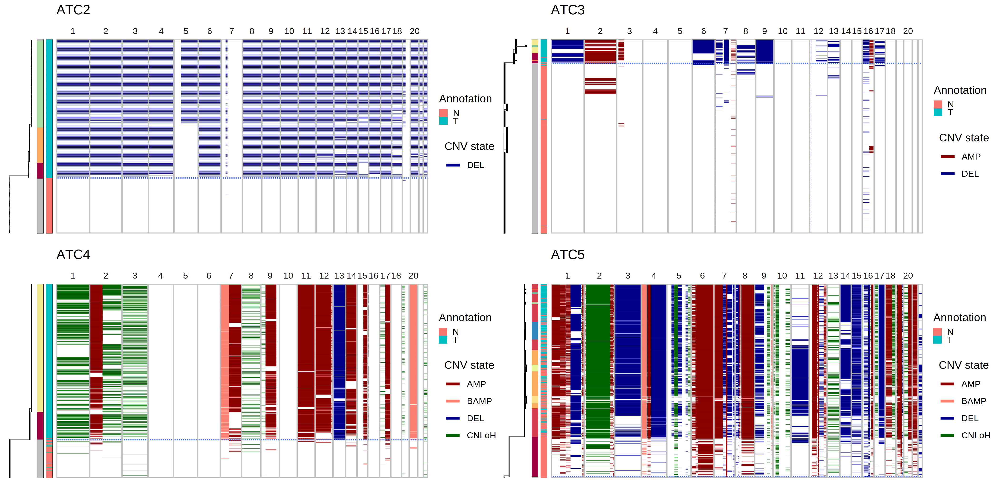

In [165]:
options(repr.plot.width = 14, repr.plot.height = 7, repr.plot.res = 300)

wrap_plots(plots, ncol = 2, guides = 'collect')

# DCIS1

In [184]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'DCIS1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

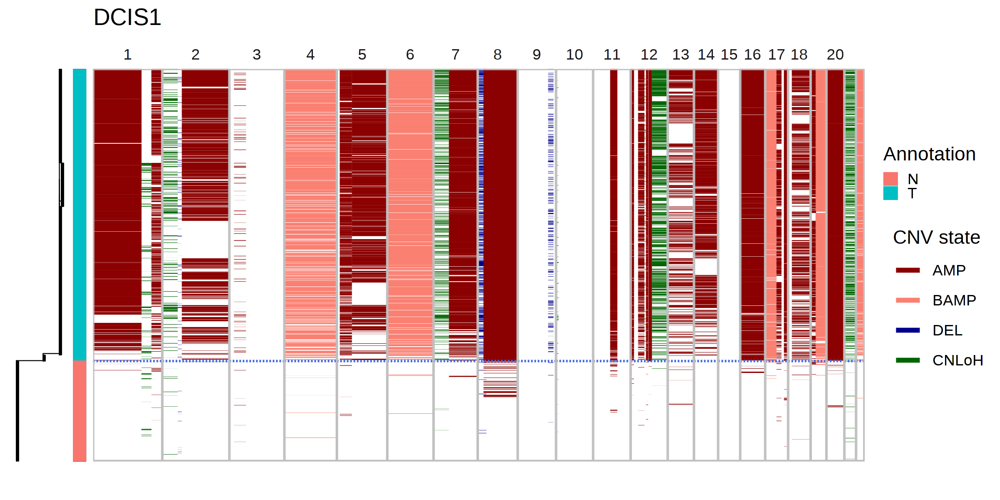

In [186]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)

sample = 'DCIS1'
plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.1,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)}
) +
ggtitle(sample)

### CNV Color legend

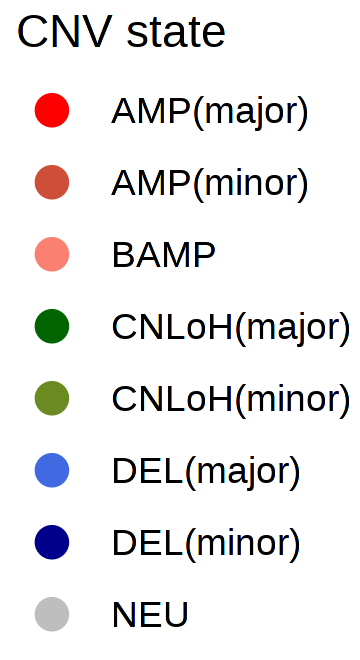

In [636]:
options(repr.plot.width = 1.2, repr.plot.height = 2.2, repr.plot.res = 300)

p = data.frame(
    state = c('AMP_up', 'AMP_down', 'DEL_up', 'DEL_down', 'CNLoH_up', 'CNLoH_down', 'NEU', 'BAMP')
) %>%
mutate(
    state = state %>% str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)')
) %>%
ggplot(
    aes(x = state, y = state, color = state)
) +
geom_point() +
scale_color_manual(values = setNames(cnv_colors, names(cnv_colors) %>% 
    str_replace('_up', '(major)') %>% 
    str_replace('_down', '(minor)') %>%
    str_replace('loh', 'CNLoH') %>%
    str_replace('bamp', 'BAMP') %>%
    str_replace('amp', 'AMP') %>%
    str_replace('del', 'DEL') %>%
    str_replace('neu', 'NEU')
)) +
theme_classic() +
guides(color = guide_legend(override.aes = aes(size = 3), title = 'CNV state'))

get_legend(p) %>% as_ggplot

Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“Removed 140582 rows containing missing values (geom_point).”


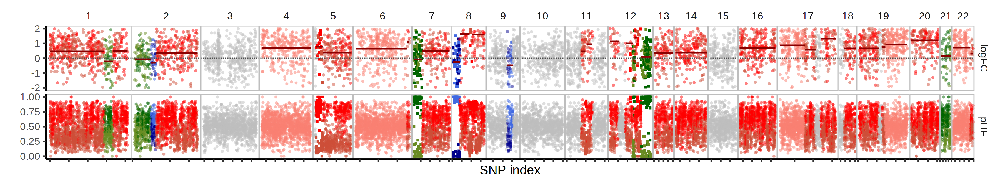

In [763]:
options(repr.plot.width = 12, repr.plot.height = 2.2, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'DCIS1'
res[[sample]]$bulk_subtrees %>% 
filter(sample %in% c(4)) %>% 
plot_psbulk(phi_mle = T, legend = F)

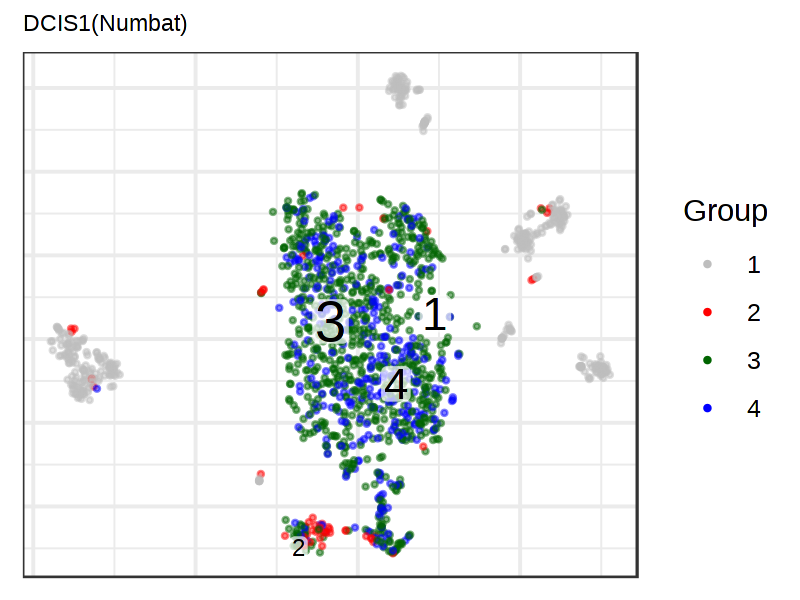

In [691]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)

con_BC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = T,
    mark.groups = T,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, '(Numbat)'),
    pal = c('gray', 'red', 'darkgreen', 'blue')
) +
theme(plot.title = element_text(size = 8))

# TNBC2

In [1138]:
res = c()

In [432]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC2'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

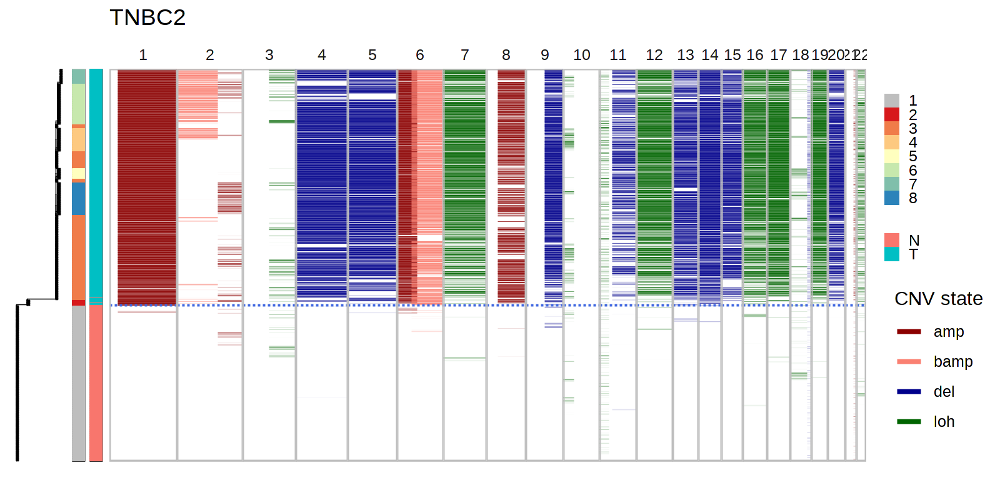

In [436]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.1,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    logBF_min = 0,
    logBF_max = 10,
    clone_bar = T
) +
ggtitle(sample)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



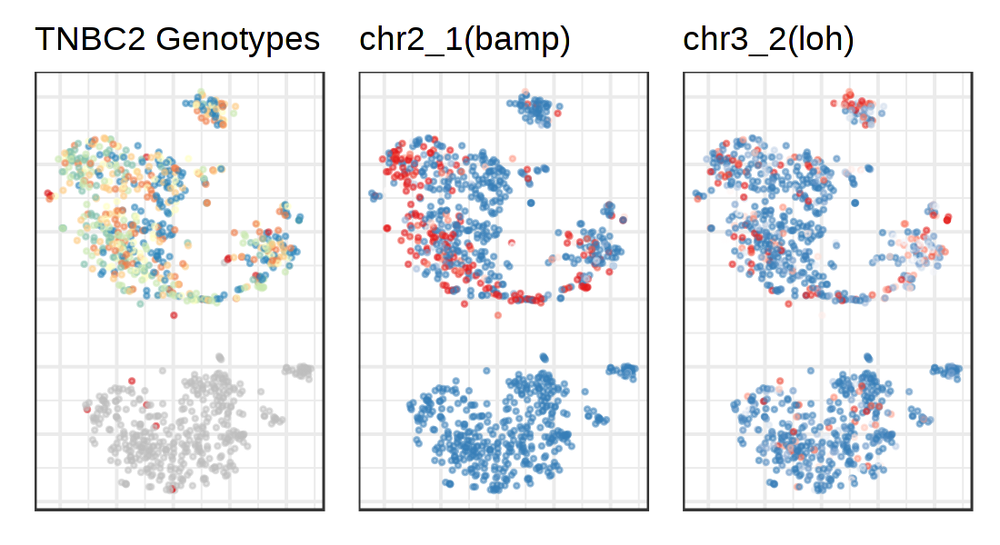

In [443]:
options(repr.plot.width = 5.5, repr.plot.height = 3, repr.plot.res = 200)
sample = 'TNBC2'
muts = c('2_1', '3_2')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' Genotypes'),
    pal = c('gray', getPalette(length(unique(res[[sample]]$clone_post$clone_opt))-1))
)
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(
                res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell'
            ) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', mut, '(', cnv_states[mut], ')')
#         title = mut
    ) +
    scale_color_gradient2(
        low = pal[2], mid = 'white', high = pal[1],
        midpoint = 0.5, guide = guide_colorbar(title = 'Posterior\nprobability'), limits = c(0,1)
    )
}

wrap_plots(plist, nrow = 1, legend = 'top')

# TNBC1

In [36]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [571]:
tree_post = res[[sample]]$tree_post
max_cost = 400

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
            simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
            label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
res[[sample]]$gtree = mark_tumor_lineage(gtree)

In [143]:
chrs = c(1,2,3)

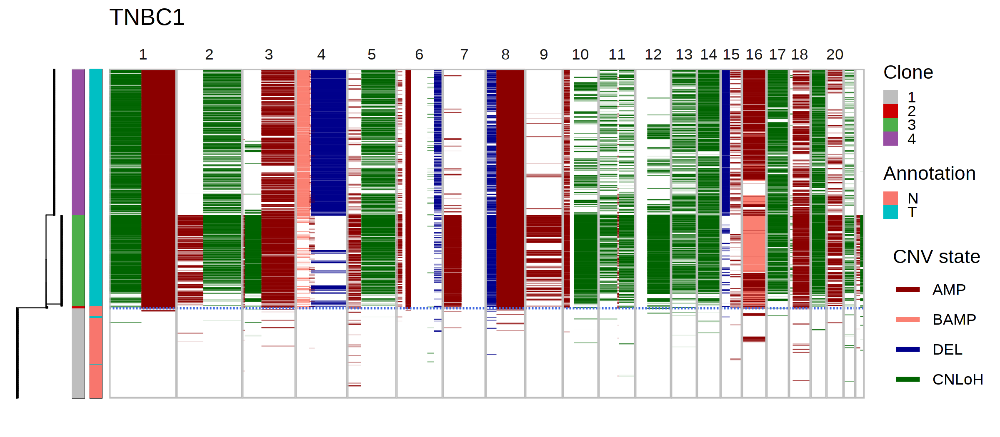

In [152]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'

getPalette = colorRampPalette(pal)

p = plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.15,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    pal_clone = c('gray', 'red3', pal[3], pal[4]),
    clone_bar = T,
    p_min = 0.9,
    multi_allelic = TRUE
) +
ggtitle(sample)

do_plot(p, 'TNBC1_phylogeny', w = 8, h = 3.5)

In [ ]:
R.utils::sourceDirectory('~/Numbat/R')

bulk = res[[sample]]$bulk_clones %>% filter(sample == 4) %>% analyze_bulk(t = 1e-1, diploid_chroms = c(13,14,19))

Retesting CNVs..



In [ ]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

bulk %>% plot_bulks(phi_mle = TRUE, legend = F)

In [261]:
R.utils::sourceDirectory('~/Numbat/R')

bulks = res[[sample]]$bulk_subtree %>% run_group_hmms(t = 1e-5, diploid_chroms = c(13,14,19))

Warning message:
“Removed 80362 rows containing missing values (geom_point).”
Warning message:
“Removed 82572 rows containing missing values (geom_point).”


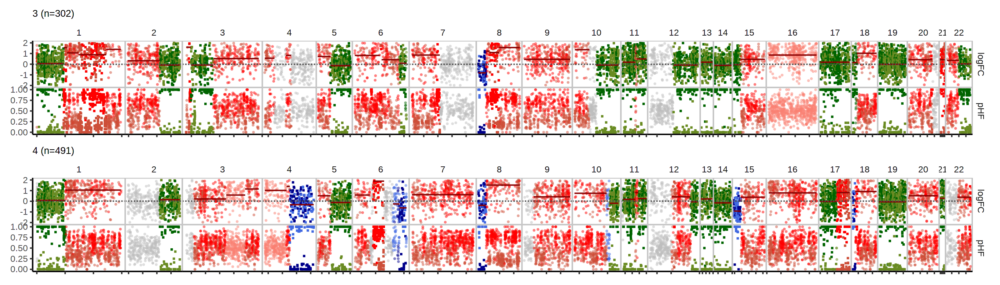

In [280]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

res[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    plot_bulks(phi_mle = TRUE, legend = F)

In [659]:
fread('~/ref/chromosome.band.hg38.txt') %>% filter(`#chrom` == 'chr15') %>% filter(gieStain == 'acen')

#chrom,chromStart,chromEnd,name,gieStain
<chr>,<int>,<int>,<chr>,<chr>
chr15,17500000,19000000,p11.1,acen
chr15,19000000,20500000,q11.1,acen


In [655]:
res[[sample]]$segs_consensus %>% 
filter(CHROM == 15)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,theta_sigma,phi_mle,phi_sigma,p_loh,p_del,p_amp,p_bamp,p_bdel,LLR,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<list>,<int>
2,15,15_1,loh_2,del,22786225,57591904,44299,44782,0.3919180,0.008315930,0.7297503,0.05187467,0.01022243,9.897776e-01,4.653027e-18,0.00000e+00,0.000000e+00,461.1024,451.2808,9.821648,124,375,20,461.1024,34805679,15_1,del,1
4,15,15_2,amp_1,amp,58817580,101659107,44790,46455,0.1692637,0.006609483,1.2944761,0.07764545,0.03139212,5.188994e-09,9.686079e-01,2.24418e-56,1.202245e-64,244.8849,235.6271,9.257848,174,1396,21,244.8849,42841527,15_2,amp,1


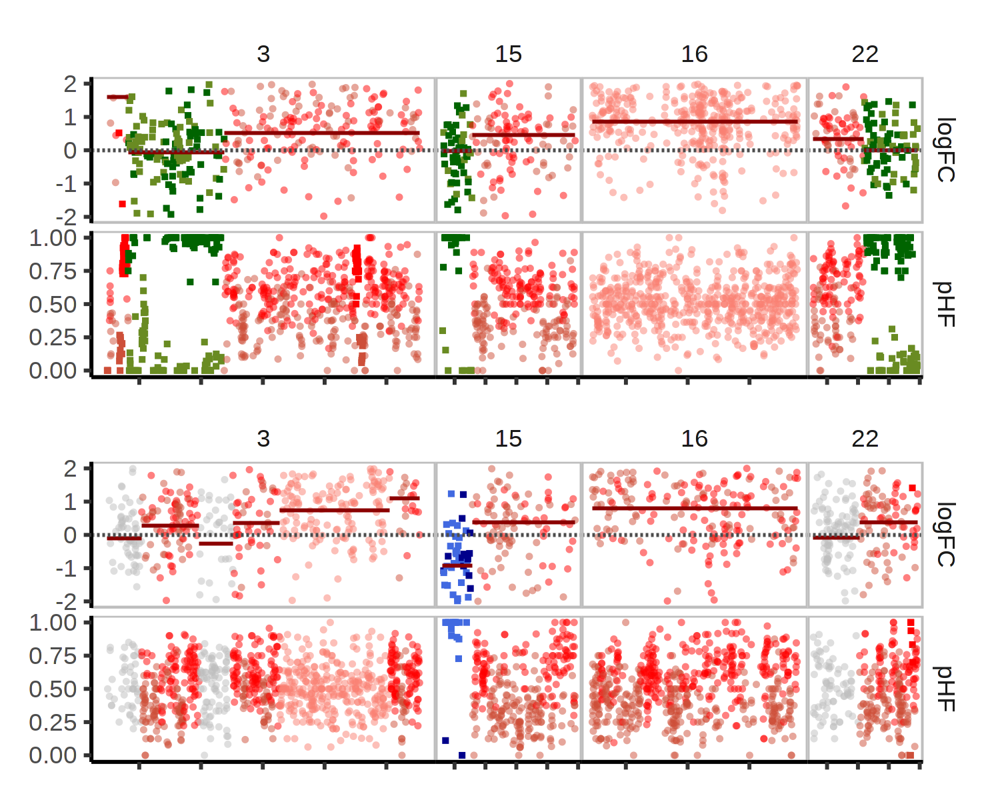

In [105]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

res[[sample]]$bulk_subtrees %>% 
    filter(sample %in% c(3,4)) %>% 
#     mutate(sample = factor(sample, c(5,4))) %>%
    mutate(state_post = ifelse(state_post == 'amp', 'bamp', state_post)) %>%
    filter(CHROM %in% c(3, 15, 16, 22)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, use_pos = F, title = F) %>%
    do_plot('TNBC1_segs', 5, 4)

Joining, by = "cell"

Warning message:
“Removed 5 rows containing missing values (geom_point).”


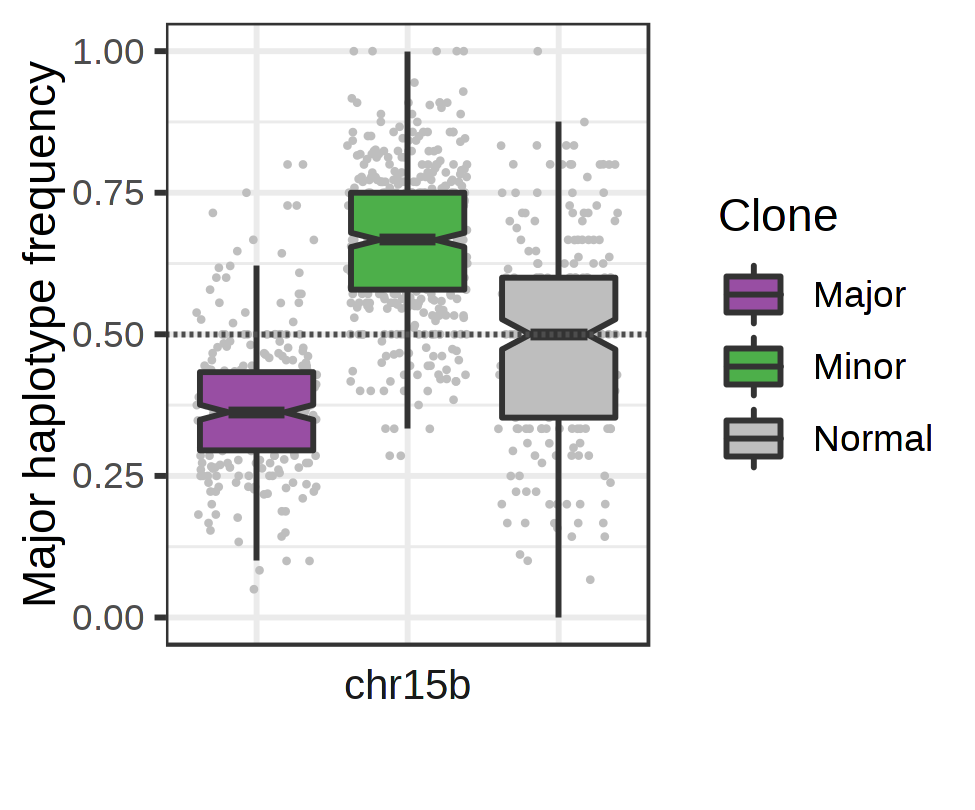

In [675]:
options(repr.plot.width = 3.25, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
# segs = c('9_2', '15_2')
segs = c('15_2')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

res[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
rowwise() %>%
mutate(seg = paste0('chr', sapply(seg, function(seg) {rename_seg(seg)}))) %>%
ungroup() %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    res[[sample]]$clone_post %>%
        mutate(clone_opt = ifelse(clone_opt %in% c(5,6), 3, clone_opt)) %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
ggplot(
    aes(x = clone, y = MAF, fill = clone)
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
scale_fill_manual(
    values = c('Normal' = 'gray', 'Minor' = pal[3], 'Major' = pal[4]),
    name = 'Clone'
) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

In [140]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [512]:
segs_consensus = get_segs_consensus(bulk_subtrees)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



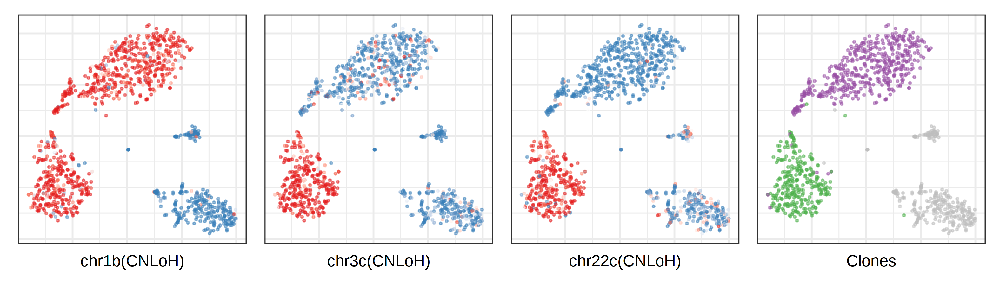

In [138]:
options(repr.plot.width = 10.5, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC1'

muts = c('1_2', '3_3', '22_3')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
        mutate(clone_opt = ifelse(clone_opt %in% c(5,6), 3, clone_opt)) %>%
        mutate(clone = c('1' = 'Normal', '3' = 'A', '4' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
) +
labs(caption = 'Clones') +
scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4])) +
theme(plot.caption = element_text(hjust = 0.5, size = 12))

plist = list()

for (cnv in muts) {
    
    plist[[cnv]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5,
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            filter(seg == cnv) %>%
            mutate(p_cnv = ifelse(seg == '16_1', p_bamp, p_cnv)) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', midpoint = 0.5, high = pal[1], limits = c(0,1)) +
    labs(caption = paste0('chr', rename_seg(cnv), '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[cnv_states[cnv]], ')')) +
    theme(plot.caption = element_text(hjust = 0.5, size = 12))
}

plist[[length(plist) + 1]] = p_clones

wrap_plots(plist, nrow = 1, legend = 'top') %>% do_plot('TNBC1_tsne', w = 10.5, h = 3)

### Probability legend

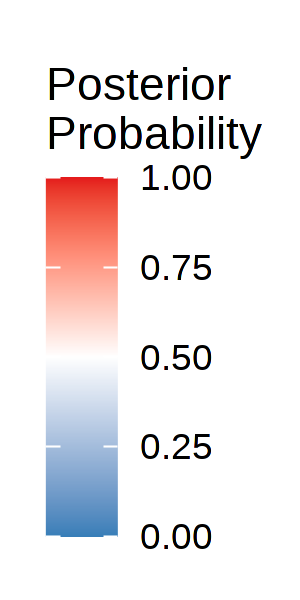

In [613]:
options(repr.plot.width = 1, repr.plot.height = 2, repr.plot.res = 300)

get_legend(
    plist[[cnv]] + theme(legend.position = 'right') +
        guides(color = guide_colorbar(title = 'Posterior\nProbability'))
) %>%
as_ggplot()

In [759]:
sample = 'TNBC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

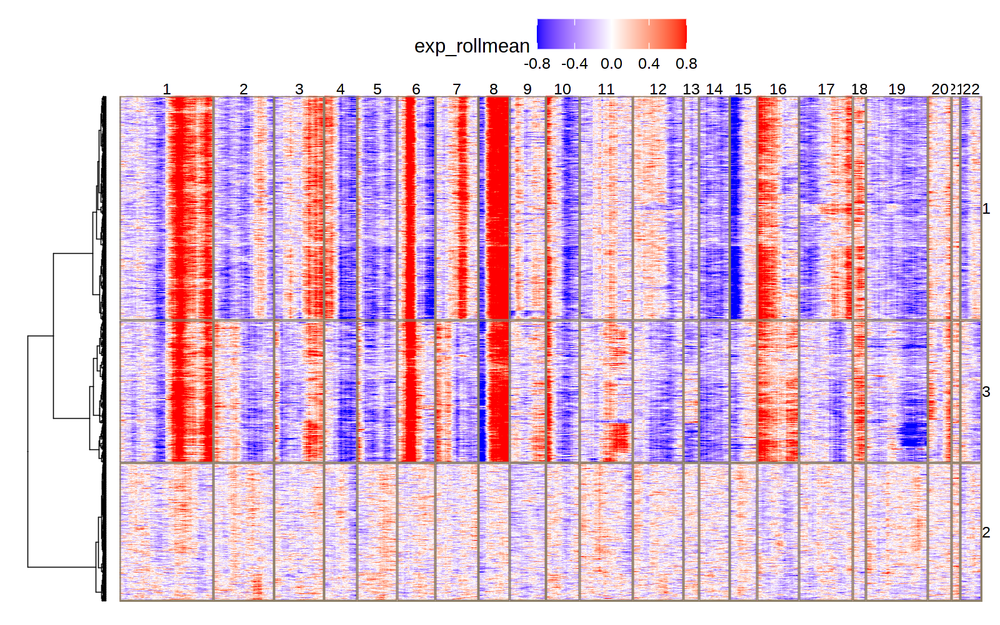

In [760]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 3,
    n_sample = 3000
)

Warning message:
“Removed 65 rows containing missing values (geom_point).”


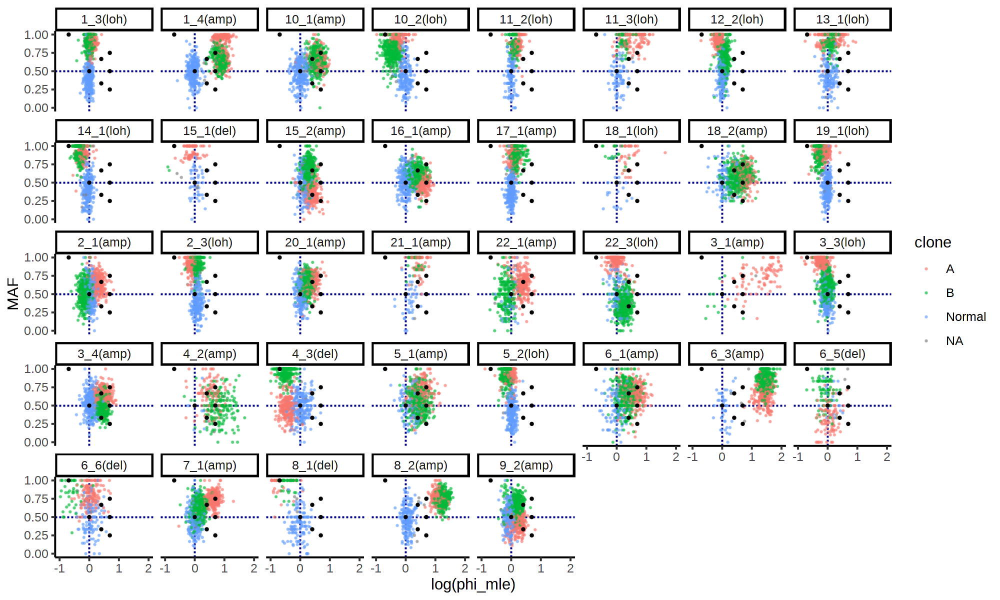

In [1591]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)

D = res[[sample]]$exp_post %>% 
    left_join(
        res[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(res[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total > 5),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 5) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC3

In [6]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC3'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

# TNBC4

In [398]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC4'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

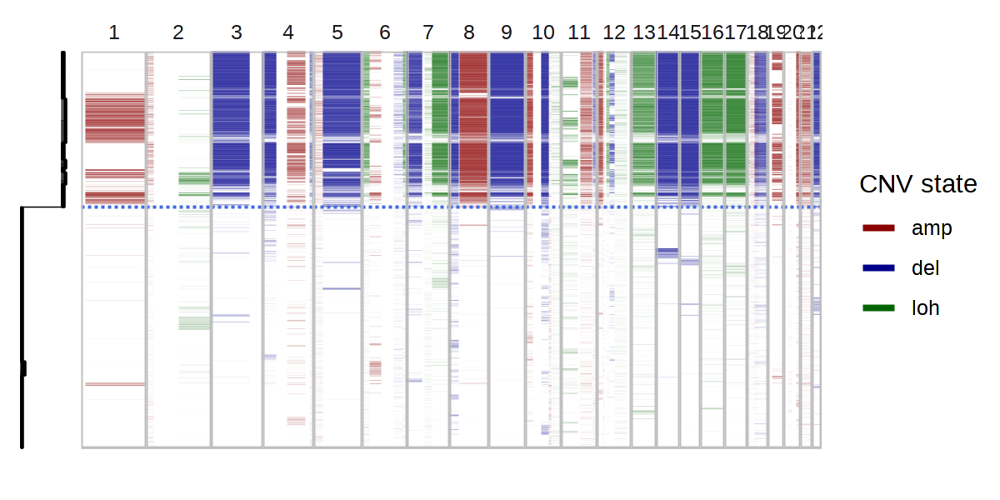

In [400]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC4'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 1,
    branch_width = 0.2,
    size = 0.02,
    logBF_min = 0,
    logBF_max = 10
)

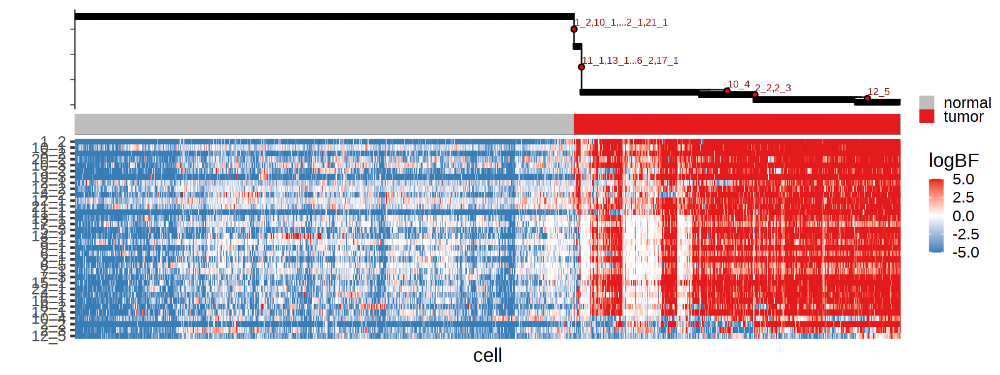

In [40]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap(
    res[[sample]]$joint_post %>% filter(seg %in% colnames(res[[sample]]$geno)),
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 2,
    ratio = 0.5,
    tvn = TRUE,
    label_mut = TRUE,
    cnv_type = FALSE
) +
theme(plot.title = element_text(size = 8))

In [846]:
# options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# res[[sample]] %>% plot_clone_panel(ratio = 0.3)

In [153]:
segs_consensus = get_segs_consensus(bulk_subtrees)

In [845]:
# options(repr.plot.width = 20, repr.plot.height = 6, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# plot_bulks(bulk_subtrees, ncol = 2)

# TNBC5

In [55]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [1192]:
for (sample in samples) {
    tree_post = res[[sample]]$tree_post
    max_cost = 400

    G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
                simplify_history(tree_post$l_matrix, max_cost = max_cost) %>% 
                label_genotype()

    mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
        select(name = node, site = label, clone = clone, GT = GT)

    # update tree
    gtree = mut_to_tree(tree_post$gtree, mut_nodes)
    res[[sample]]$gtree = mark_tumor_lineage(gtree)
}

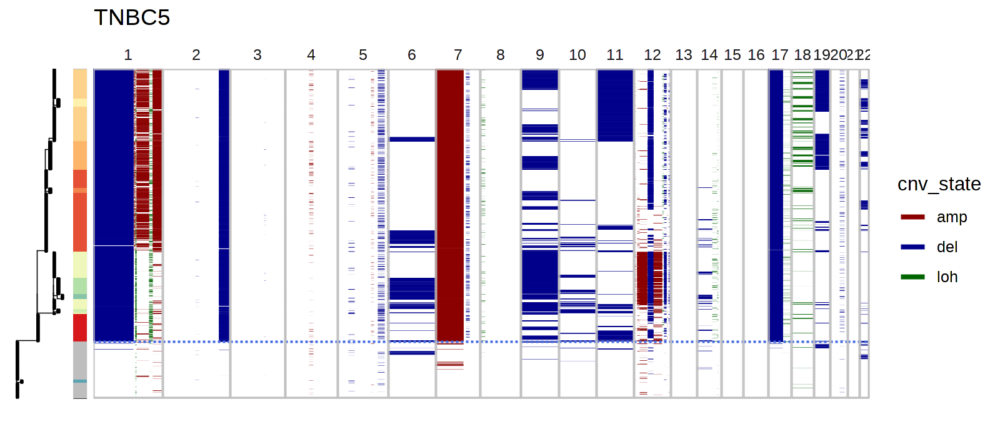

In [1190]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post %>% mutate(cnv_state = ifelse(cnv_state == 'bdel', 'del', cnv_state)),
    res[[sample]]$segs_consensus,
    tip_length = 0.5,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
#     cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = T,
#     pal_clone = c('gray', getPalette(15)),
    clone_legend = F
) +
ggtitle(sample)

In [91]:
res[['TNBC5']]$segs_consensus %>% filter(CHROM == 1)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,theta_sigma,phi_mle,phi_sigma,p_loh,p_del,p_amp,p_bamp,p_bdel,LLR,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<list>,<int>
2,1,1a,del_2,del,758351,144887191,1,1827,0.3527830,0.005002428,0.5658678,0.02178157,0.00000000,1.000000e+00,0.00000000,0.000000e+00,0.00000e+00,1281.2678,1171.8593,109.40841481,511,1261,1,1281.268,144128840,1_1,del,1
NA,1,,neu,neu,144887192,145607987,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,720795,1_2,neu,0
4,1,1b,amp_1,amp,145607988,150494917,1828,2561,0.1306470,0.006140863,1.5095009,0.24756382,0.06936805,3.861296e-03,0.92677066,5.242395e-27,2.18419e-29,218.0070,214.8550,3.15203335,28,704,2,2516.066,4886929,1_3,amp,1
NA,1,,neu,neu,150494918,150495882,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,964,1_4,neu,0
4,1,1c,loh_1,loh,150495883,156229070,2562,3182,0.1541040,0.008364763,0.9773580,0.09040004,0.89247448,7.944317e-02,0.02808234,2.388431e-28,6.75672e-28,157.5875,157.5568,0.03065618,89,543,2,2516.066,5733187,1_5,loh,1
NA,1,,neu,neu,156229071,156229202,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,131,1_6,neu,0
4,1,1d,amp_1,amp,156229203,248906235,3183,11815,0.1614879,0.002118620,1.3049398,0.06686070,0.01024227,5.077321e-12,0.98975773,0.000000e+00,0.00000e+00,2516.0659,2502.5737,13.49215480,288,8022,2,2516.066,92677032,1_7,amp,1


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



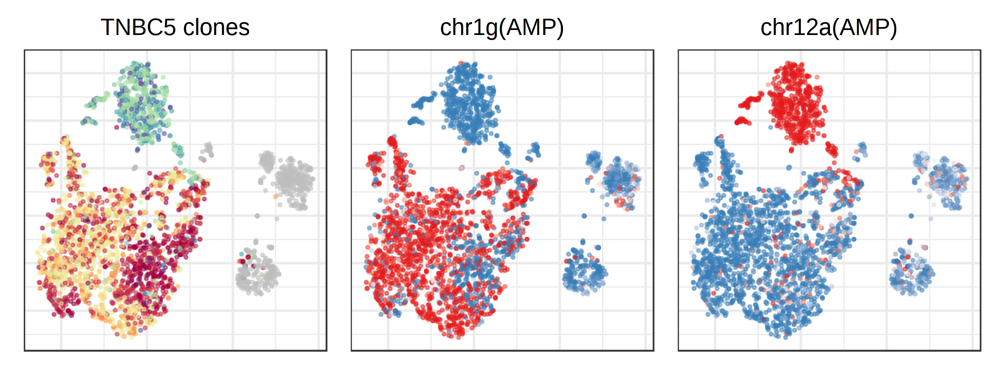

In [92]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC5'
muts = c('1_7', '12_1')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 10, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = res[[sample]]$clone_post %>%
#         mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
    pal = c('gray', getPalette(length(unique(res[[sample]]$clone_post$clone_opt))-1))
) +
theme(plot.title = element_text(hjust = 0.5))
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', rename_seg(mut), '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))
}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC1

In [22]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

In [874]:
R.utils::sourceDirectory('~/Numbat/R')

joint_post = get_joint_post(
    res[[sample]]$exp_post,
    res[[sample]]$allele_post,
    res[[sample]]$segs_consensus %>% 
        mutate(p_loh = 1/3, p_amp = 1/3, p_del = 1/3)
)

In [ ]:
sample = 'ATC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

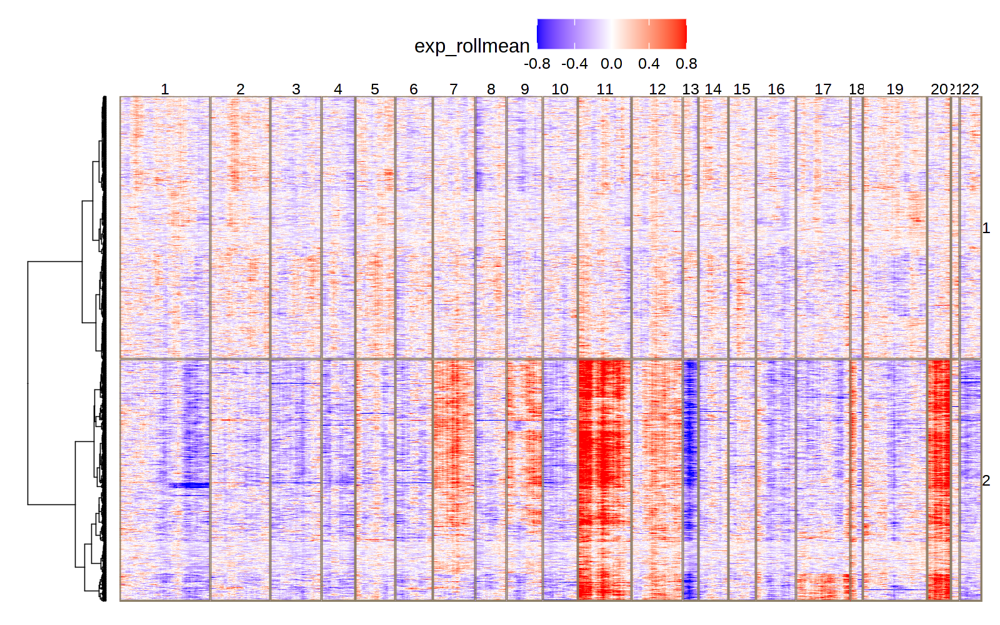

In [970]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 2,
    n_sample = 3000
)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



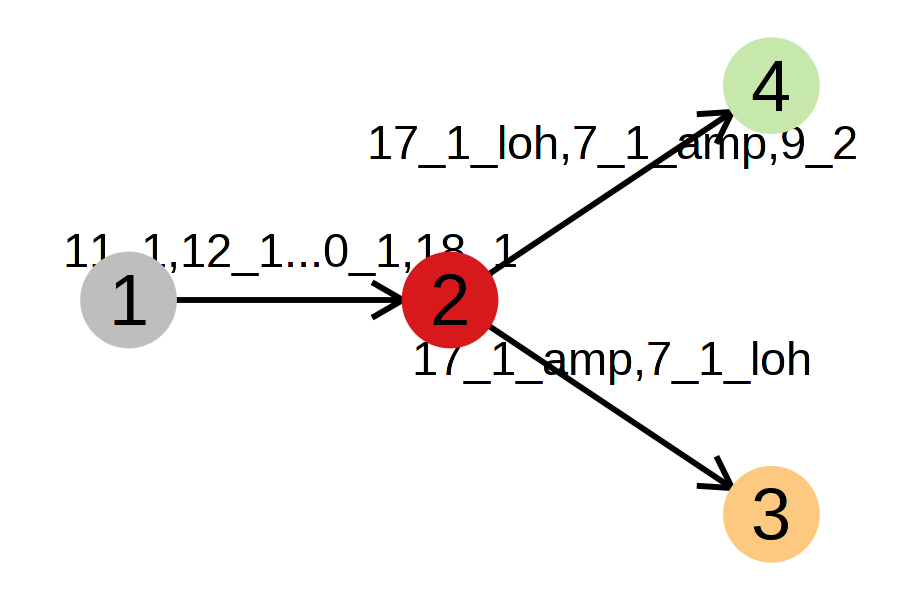

In [27]:
options(repr.plot.width = 3, repr.plot.height = 2, repr.plot.res = 300)

res[[sample]]$G_m %>% plot_mut_history()

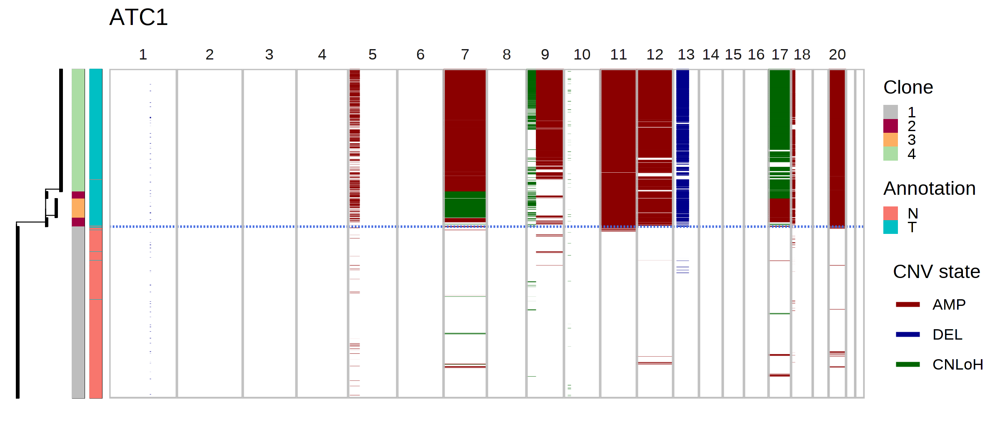

In [153]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC1'
plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 0.5,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = T,
    multi_allelic = TRUE
) +
ggtitle(sample)

Retesting CNVs..

Finishing..

Warning message:
“Removed 139682 rows containing missing values (geom_point).”


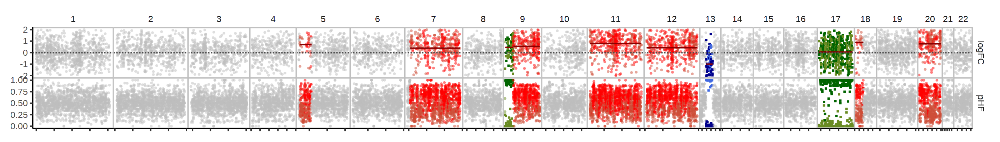

In [244]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

bulk = res[[sample]]$bulk_clones %>%
    filter(sample %in% 4) %>%
    analyze_bulk(find_diploid = F, lambda = 2, t = 1e-6) 

bulk %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

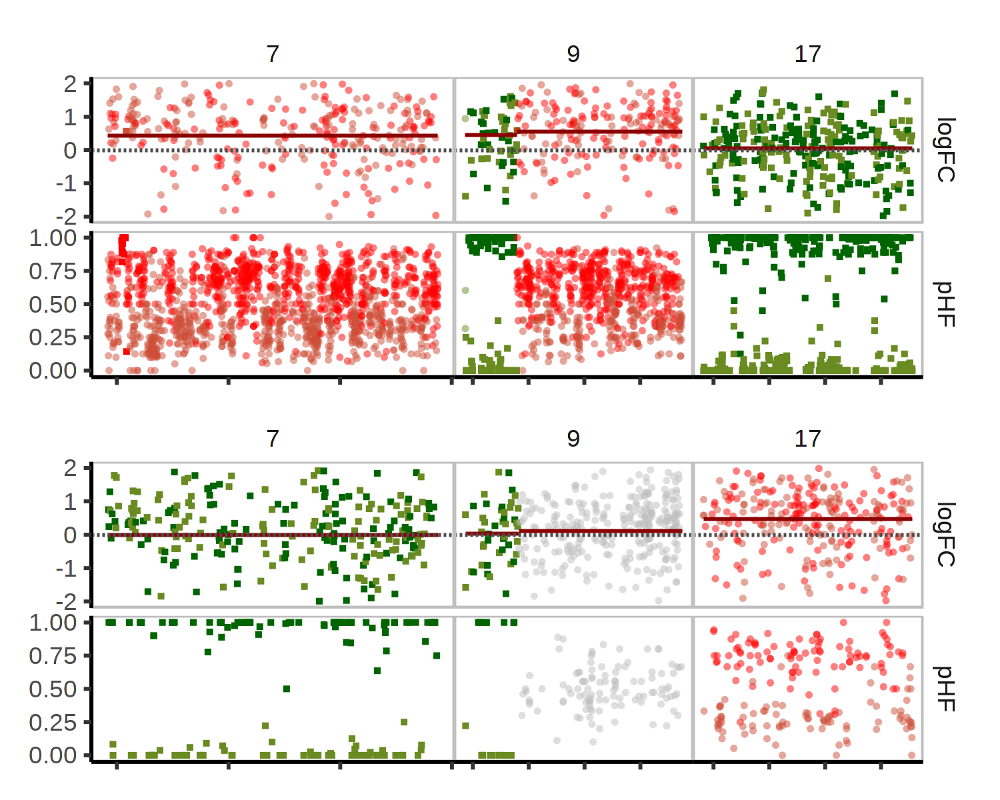

In [35]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
res[[sample]]$bulk_clones %>% 
filter(sample %in% c(3,4)) %>%
mutate(sample = factor(sample, c(4,3))) %>%
filter(CHROM %in% c(7, 9, 17)) %>%
group_by(sample, seg) %>%
mutate(
    approx_lik_exp(
        Y_obs[!is.na(Y_obs)], lambda_ref[!is.na(Y_obs)], unique(na.omit(d_obs)),
        mu = mu[!is.na(Y_obs)],
        sig = sig[!is.na(Y_obs)]
    )
) %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

Joining, by = "cell"

Warning message:
“Removed 189 rows containing missing values (geom_point).”


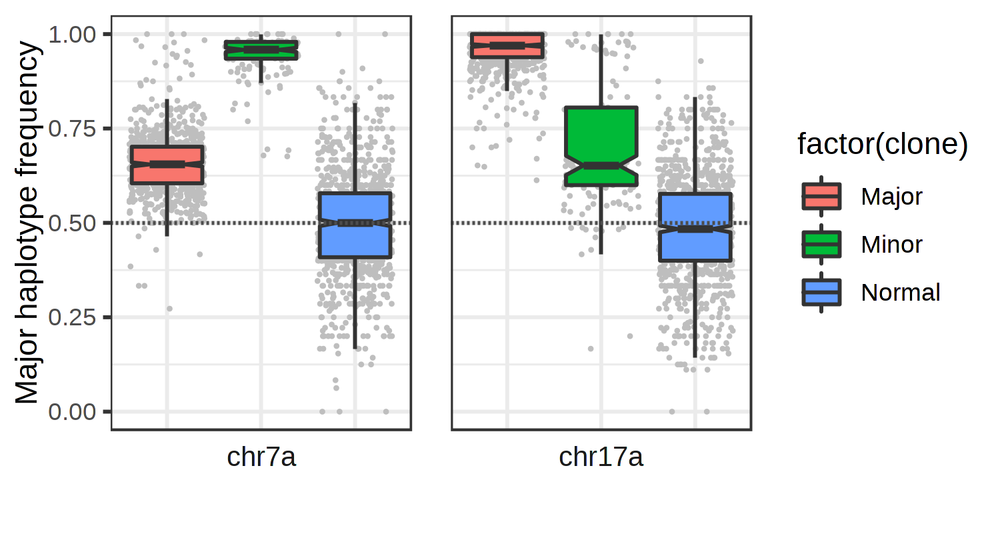

In [668]:
options(repr.plot.width = 5, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
segs = c('7_1', '17_1')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

res[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
mutate(seg = paste0('chr', sapply(seg, function(seg) {rename_seg(seg)}))) %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    res[[sample]]$clone_post %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
ggplot(
    aes(x = clone, y = MAF, fill = factor(clone))
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
# scale_fill_manual(
#     values = c('Normal' = 'gray', 'Minor' = pal[3], 'Major' = pal[4]),
#     name = 'Clone'
# ) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



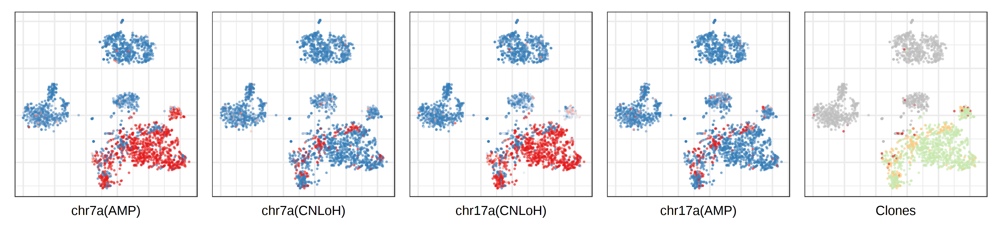

In [140]:
options(repr.plot.width = 13, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC1'
con_sample = con_ATC$samples[[sample]]

getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

plot_list = list()

cnvs = c('7_1_amp', '7_1_loh', '17_1_loh', '17_1_amp')

joint_post = expand_states(res[[sample]]$joint_post, res[[sample]]$segs_consensus)

for (cnv in cnvs) {

    plot_list[[cnv]] = con_sample$plotEmbedding(
            plot.na = F, 
            alpha = 0.5,
            size = 0.3,
            colors = joint_post %>% 
                filter(seg == cnv) %>%
                {setNames(.$p_cnv, .$cell)},
            mark.groups = F,
            plot.theme = theme_bw()
        ) +
        scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1], midpoint = 0.5) +
        labs(caption = paste0('chr', rename_seg(cnv), '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[str_extract(cnv, 'amp|loh|del')], ')')) +
        theme(plot.caption = element_text(hjust = 0.5, size = 12))
}


plot_list[[length(plot_list)+1]] = con_sample$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.3,
    palette = c('gray', getPalette(4)),
    groups = res[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F
) +
labs(caption = 'Clones') +
theme(plot.caption = element_text(hjust = 0.5, size = 12))
# guides(colour = guide_legend(override.aes = list(size = 2)))

wrap_plots(plot_list, nrow = 1) %>% do_plot('ATC1_tsne', w = 13, h = 3)

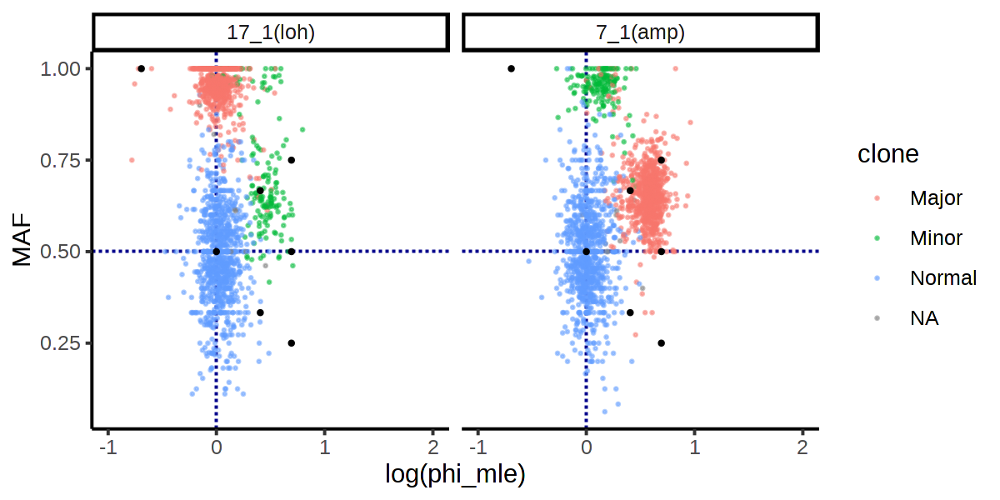

In [674]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

D = res[[sample]]$exp_post %>% 
    filter(seg %in% segs) %>%
    left_join(
        res[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(res[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = clone_dict[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 1) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# ATC2

In [31]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2_subsampled'
res[['ATC2']] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

Warning message:
“The `x` argument of `as_tibble.matrix()` must have unique column names if `.name_repair` is omitted as of tibble 2.0.0.
Using compatibility `.name_repair`.
This warning is displayed once every 8 hours.
Call `lifecycle::last_warnings()` to see where this warning was generated.”


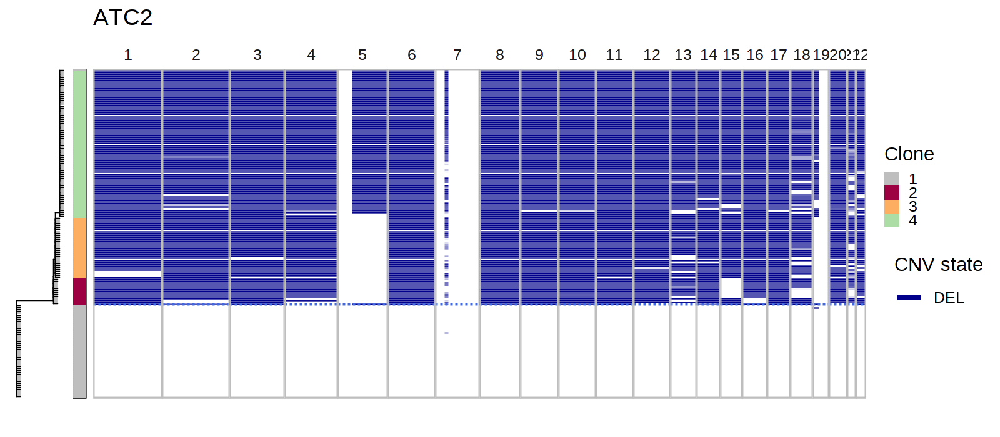

In [8]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 2,
    branch_width = 0.2,
    size = 0.3,
    clone_bar = T,
#     cell_dict = cell_annot[['ATC2']] %>% {setNames(.$cluster.pred, .$cell)},
#     pal_clone = c('gray', pal[3], pal[4])
) +
ggtitle('ATC2')

In [100]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'
res[[sample]] = fetch_results(glue('~/paper_data/numbat_out/{sample}'), i = 2)

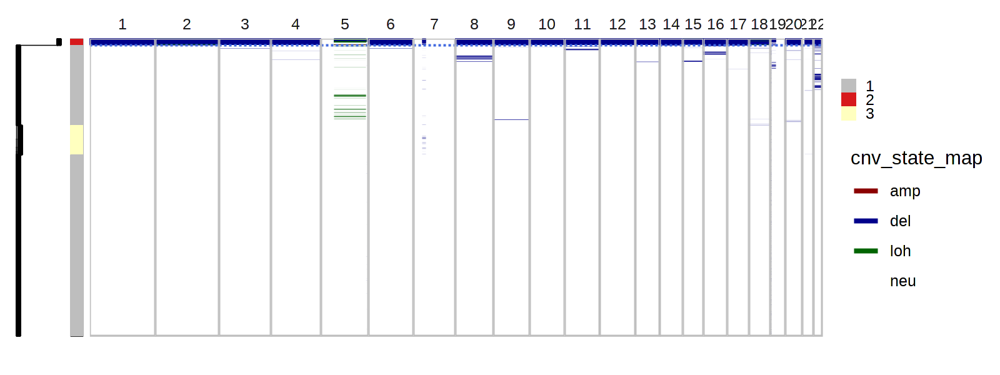

In [101]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 2,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10,
    clone_bar = T
)

Warning message:
“Removed 117483 rows containing missing values (geom_point).”
Warning message:
“Removed 87967 rows containing missing values (geom_point).”
Warning message:
“Removed 56200 rows containing missing values (geom_point).”
Warning message:
“Removed 45542 rows containing missing values (geom_point).”
Warning message:
“Removed 66839 rows containing missing values (geom_point).”


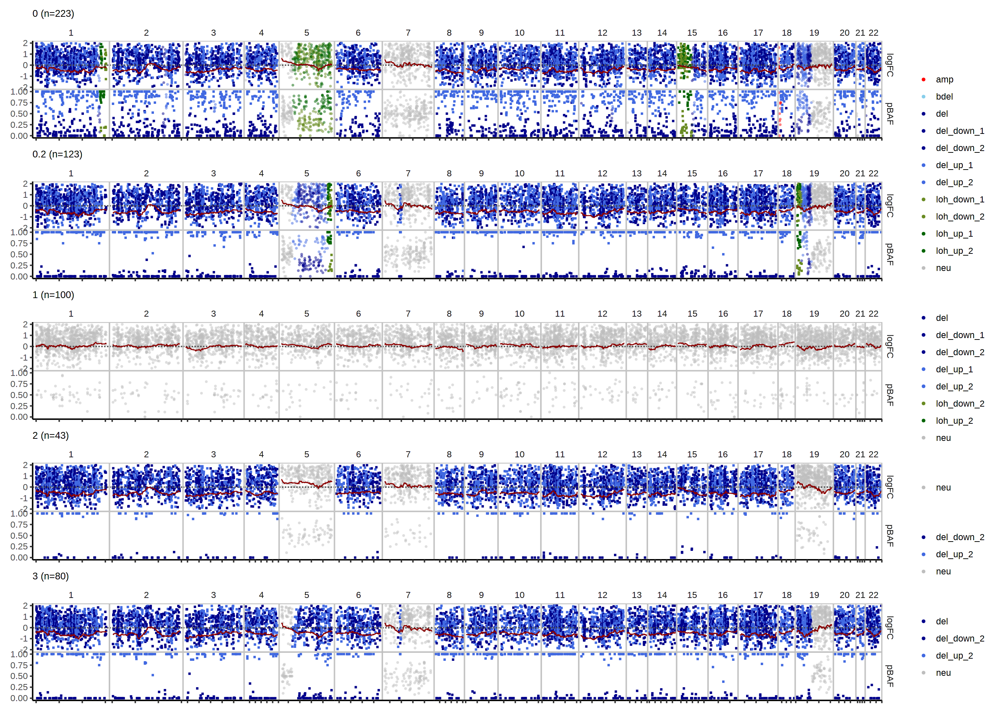

In [544]:
options(repr.plot.width = 14, repr.plot.height = 10, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(bulk0)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



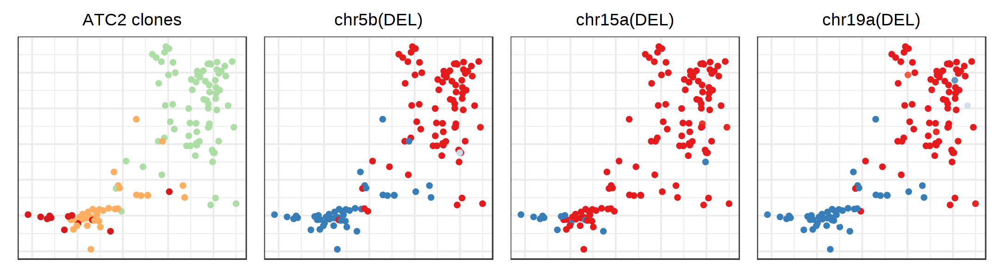

In [32]:
options(repr.plot.width = 10.8, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC2'
muts = c('5_2', '15_1', '19_1')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = res[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 4, 'Spectral'))

p_clones = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
    groups = res[[sample]]$clone_post %>%
        filter(!clone_opt %in% c(1)) %>%
#         mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
    pal = c(getPalette(length(unique(res[[sample]]$clone_post$clone))))
) +
theme(plot.title = element_text(hjust = 0.5))
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[['clones']] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
        plot.na = F, 
        colors = res[[sample]]$joint_post %>%
            left_join(res[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(!clone_opt %in% c(1)) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', rename_seg(mut), '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))

}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC3

In [660]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC3'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

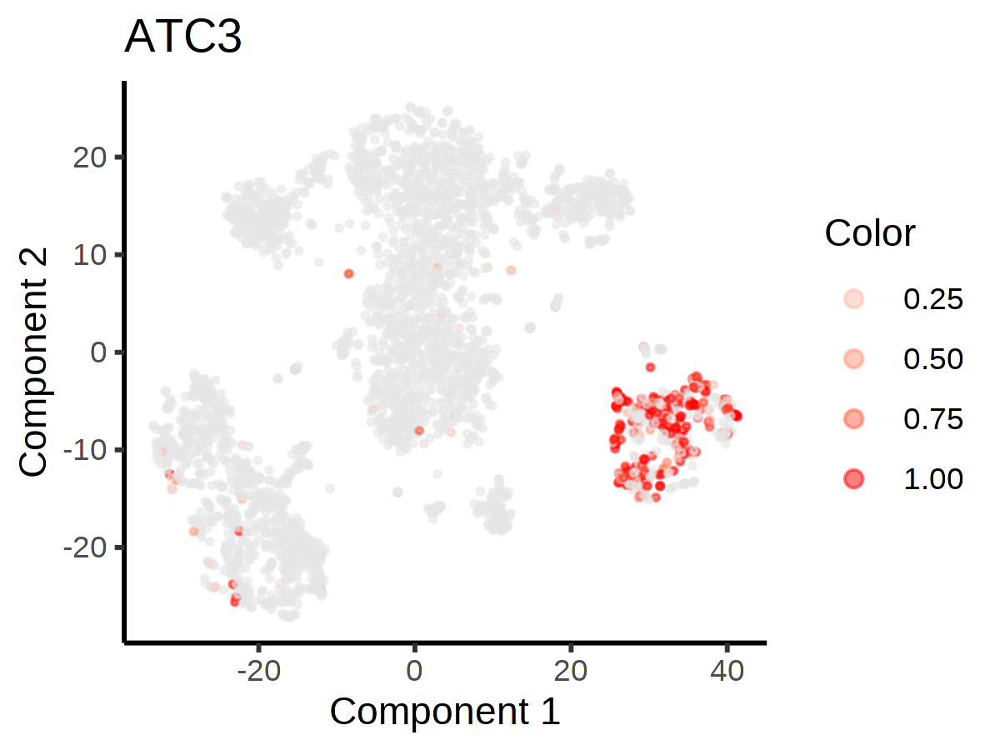

In [1233]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 300)
sample = 'ATC3'
con_ATC$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.5,
    color = res[[sample]]$joint_post %>% 
        filter(seg == '6_2') %>%
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
    title = sample
) +
theme_classic() +
guides(colour = guide_legend(override.aes = list(size = 2)))

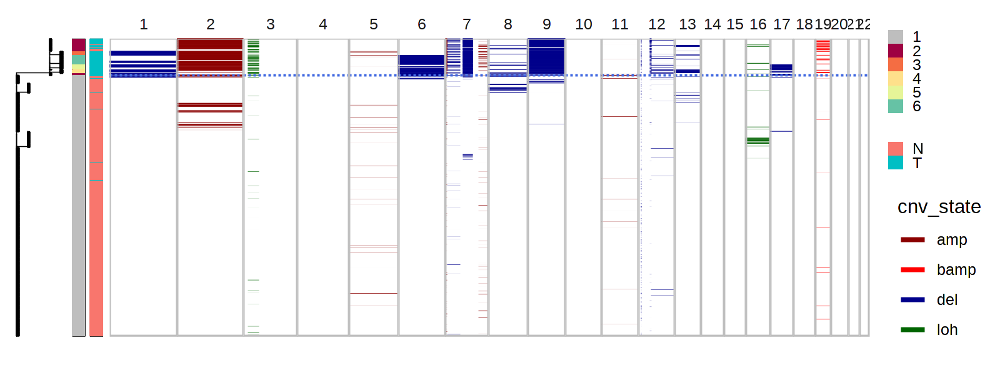

In [663]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    branch_width = 0.2,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    clone_bar = T
)

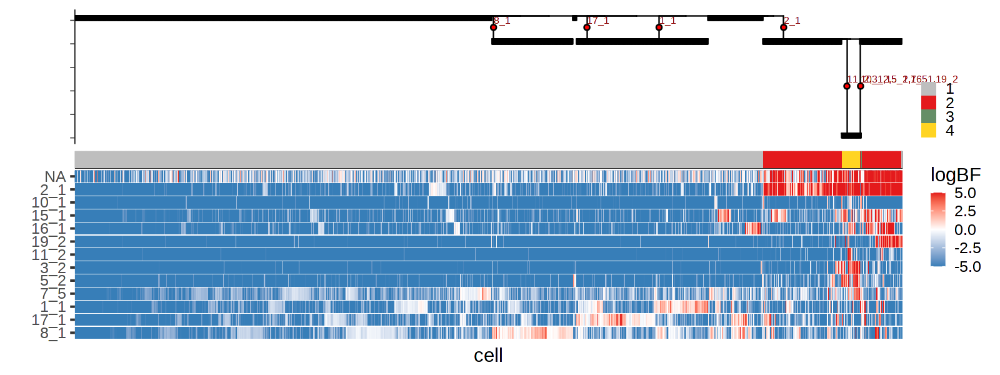

In [585]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC3'
tree_heatmap(
    res[[sample]]$joint_post,
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    ratio = 0.8,
    tvn = F,
    label_mut = T,
    cnv_type = F
) +
theme(plot.title = element_text(size = 8))

Warning message:
“Removed 109907 rows containing missing values (geom_point).”
Warning message:
“Removed 78436 rows containing missing values (geom_point).”
Warning message:
“Removed 95662 rows containing missing values (geom_point).”
Warning message:
“Removed 37928 rows containing missing values (geom_point).”
Warning message:
“Removed 68122 rows containing missing values (geom_point).”


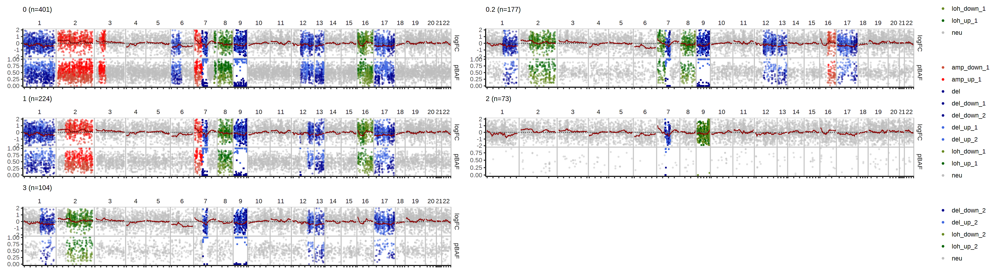

In [19]:
options(repr.plot.width = 20, repr.plot.height = 5.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(bulk0, ncol = 2)

In [80]:
segs_consensus = get_segs_consensus(bulk_subtrees)

In [186]:
G_m = mut_tree_file %>% 
    read_mut_tree(tree_post$mut_nodes) %>%
    simplify_history(tree_post$l_matrix, max_cost = 150) %>%
    label_genotype()

mut_nodes = G_m %>% as_data_frame('vertices') %>% select(name = node, site = label)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)

opt_move:7_4->9_2, cost=2.91

opt_move:13_2->17_2, cost=6.37

opt_move:6_2->13_2,17_2, cost=88.4

opt_move:12_2->7_2, cost=143

Seems like we're catching a real event in the adjacent normal cells

In [88]:
segs_consensus = get_segs_consensus(bulk_subtrees)

Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“Removed 6691 rows containing missing values (geom_point).”


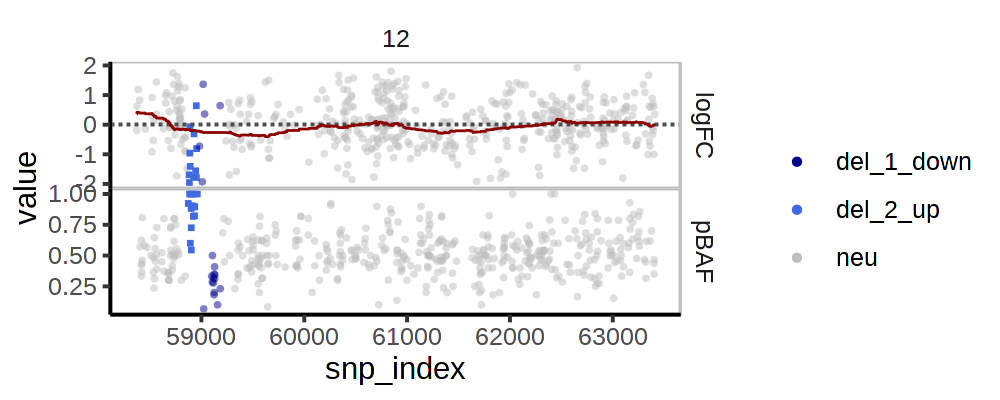

In [126]:
options(repr.plot.width = 5, repr.plot.height = 2, repr.plot.res = 200)

bulk_clones %>% filter(sample == 2) %>% filter(CHROM == 12) %>% plot_psbulk()

Warning message:
“Using alpha for a discrete variable is not advised.”
Warning message:
“Removed 7810 rows containing missing values (geom_point).”


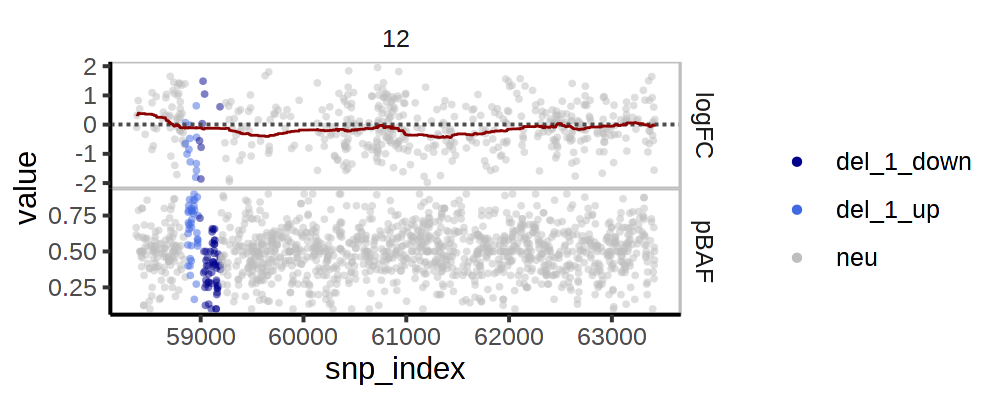

In [124]:
options(repr.plot.width = 5, repr.plot.height = 2, repr.plot.res = 200)

bulk %>% filter(CHROM == 12) %>% plot_psbulk()

In [188]:
cell_sample = colnames(geno)

# ATC4

In [1233]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC4'
out_dir = glue('~/results/tvn/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

# ATC5

In [269]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

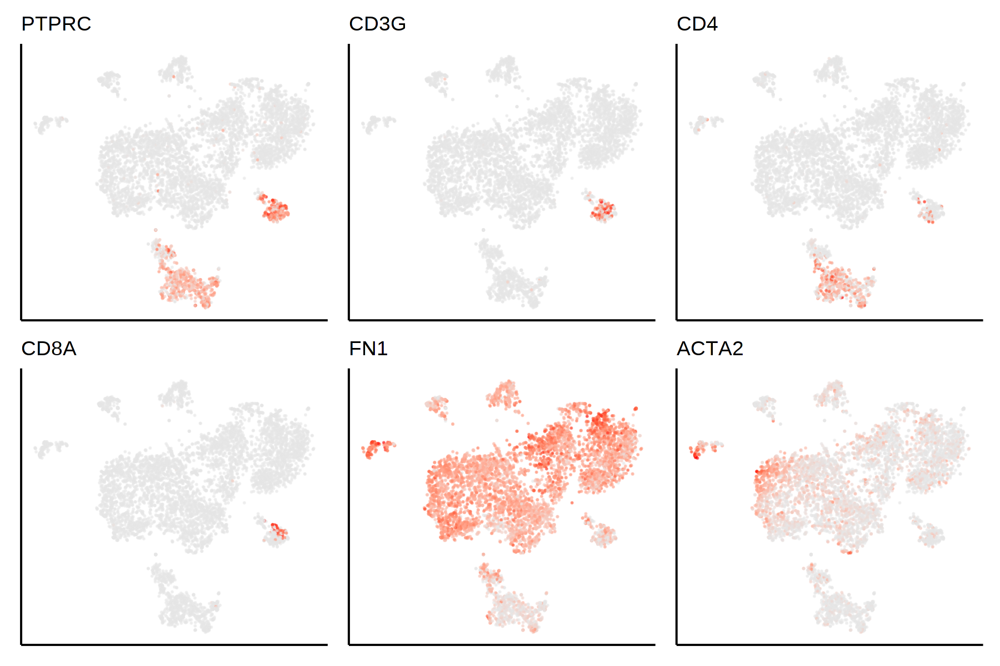

In [203]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

con_sample = con_ATC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'CD3G', 'CD4', 'CD8A', 'FN1', 'ACTA2'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

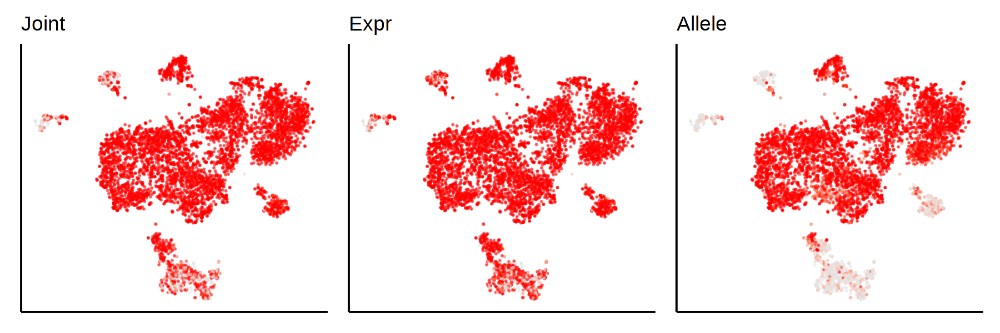

In [270]:
options(repr.plot.width = 9, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC5'
con_sample = con_ATC$samples[[sample]]

p1 = con_sample$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
    title = 'Joint',
    plot.theme = theme_classic()
)

p2 = con_sample$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        {setNames(.$p_cnv_x, .$cell)},
    mark.groups = F,
    title = 'Expr',
    show.legend = F,
    plot.theme = theme_classic()
)

p3 = con_sample$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        {setNames(.$p_cnv_y, .$cell)},
    mark.groups = F,
    title = 'Allele',
    show.legend = F,
    plot.theme = theme_classic()
)

p1 | p2 | p3

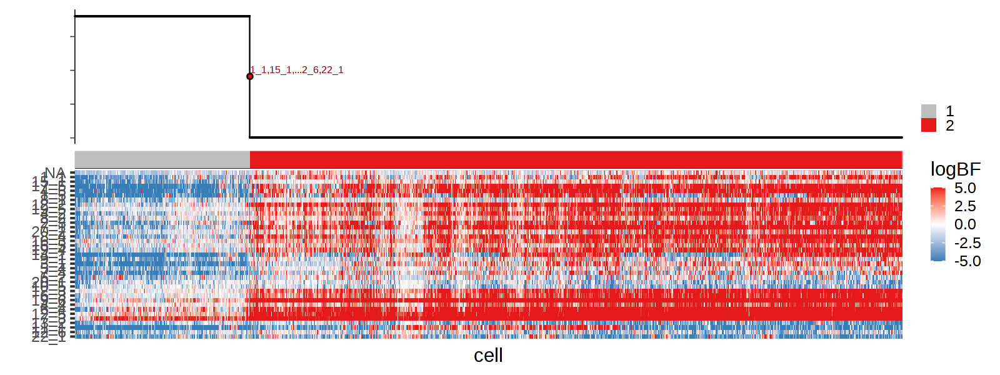

In [188]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC5'
tree_heatmap(
    res[[sample]]$joint_post,
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    ratio = 0.8,
    tvn = F,
    label_mut = T,
    cnv_type = F
) +
theme(plot.title = element_text(size = 8))

In [167]:
library(logger)
library(ggraph)

In [182]:
sample = 'ATC5'
tree_post = res[[sample]]$tree_post
max_cost = 2e5

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
    simplify_history(tree_post$l_matrix, max_cost = max_cost, verbose = T) %>% 
    label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
res[[sample]]$gtree = mark_tumor_lineage(gtree)

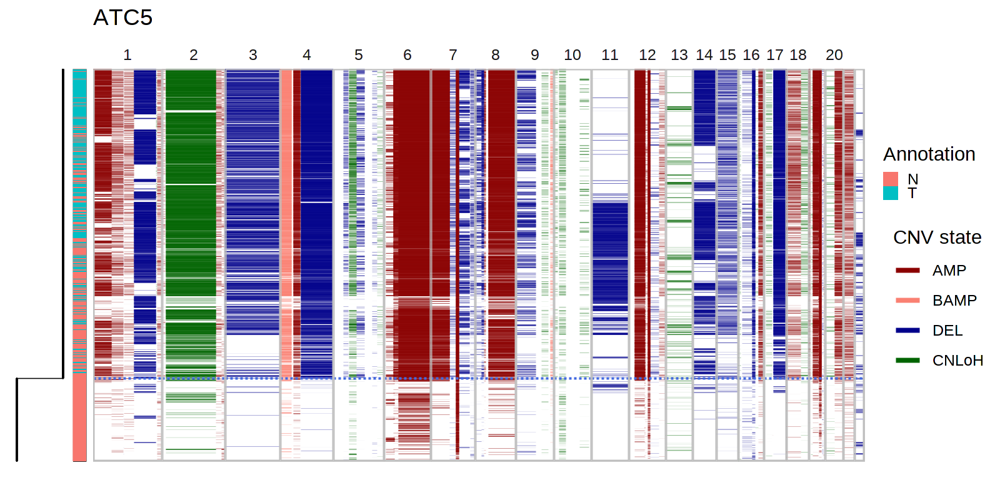

In [183]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

plot_sc_joint(
    gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    tip_length = 0.5,
    branch_width = 0.2,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)}
) +
ggtitle(sample)

Warning message:
“Removed 127585 rows containing missing values (geom_point).”
Warning message:
“Removed 108463 rows containing missing values (geom_point).”
Warning message:
“Removed 283352 rows containing missing values (geom_point).”
Warning message:
“Removed 279457 rows containing missing values (geom_point).”
Warning message:
“Removed 150082 rows containing missing values (geom_point).”
Warning message:
“Removed 173058 rows containing missing values (geom_point).”
Warning message:
“Removed 244497 rows containing missing values (geom_point).”


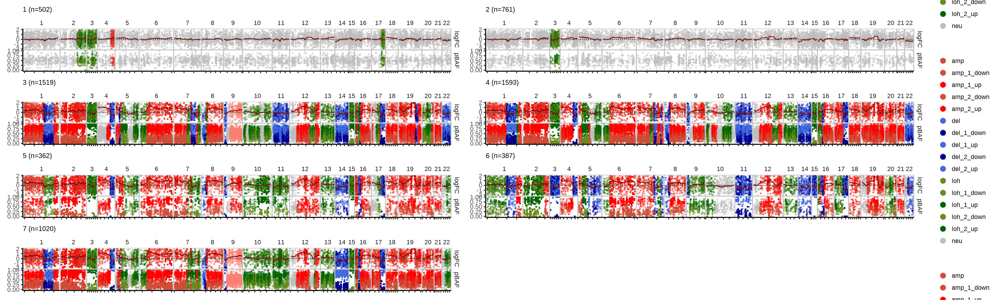

In [281]:
options(repr.plot.width = 20, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(res[[sample]]$bulk_clones, ncol = 2)

In [57]:
clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))